In [30]:
# ! pip3 install geopandas

# post fire damage data

In [150]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import plotly.express as px
import shapely
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import geopandas as gpd
import fiona

datasets:
- Combined wildfire datasets for the United States and certain territories, 1878-2019
- https://www.sciencebase.gov/catalog/item/5ee13de982ce3bd58d7be7e7


In [32]:
damages = gpd.read_file("./archive/POSTFIRE_MASTER_DATA_SHARE_140463065990229786.geojson")

In [33]:
damages.columns

Index(['OBJECTID', 'DAMAGE', 'STREETNUMBER', 'STREETNAME', 'STREETTYPE',
       'STREETSUFFIX', 'CITY', 'STATE', 'ZIPCODE', 'CALFIREUNIT', 'COUNTY',
       'COMMUNITY', 'BATTALION', 'INCIDENTNAME', 'INCIDENTNUM',
       'INCIDENTSTARTDATE', 'HAZARDTYPE', 'WHEREFIRESTARTEDONSTRUCTURE',
       'WHATDIDFIRESTARTFROM', 'DEFENSIVEACTIONS', 'STRUCTURETYPE',
       'STRUCTURECATEGORY', 'NUMBEROFUNITPERSTRUCTURE',
       'NOOUTBUILDINGSDAMAGED', 'NOOUTBUILDINGSNOTDAMAGED', 'ROOFCONSTRUCTION',
       'EAVES', 'VENTSCREEN', 'EXTERIORSIDING', 'WINDOWPANE',
       'DECKPORCHONGRADE', 'DECKPORCHELEVATED', 'PATIOCOVERCARPORT',
       'FENCEATTACHEDTOSTRUCTURE', 'PROPANETANKDISTANCE',
       'UTILITYMISCSTRUCTUREDISTANCE', 'FIRENAME', 'APN',
       'ASSESSEDIMPROVEDVALUE', 'YEARBUILT', 'SITEADDRESS', 'GLOBALID',
       'Latitude', 'Longitude', 'geometry'],
      dtype='object')

In [34]:
damages.dtypes 

OBJECTID                           int32
DAMAGE                            object
STREETNUMBER                     float64
STREETNAME                        object
STREETTYPE                        object
STREETSUFFIX                      object
CITY                              object
STATE                             object
ZIPCODE                          float64
CALFIREUNIT                       object
COUNTY                            object
COMMUNITY                         object
BATTALION                         object
INCIDENTNAME                      object
INCIDENTNUM                       object
INCIDENTSTARTDATE                 object
HAZARDTYPE                        object
WHEREFIRESTARTEDONSTRUCTURE       object
WHATDIDFIRESTARTFROM              object
DEFENSIVEACTIONS                  object
STRUCTURETYPE                     object
STRUCTURECATEGORY                 object
NUMBEROFUNITPERSTRUCTURE         float64
NOOUTBUILDINGSDAMAGED            float64
NOOUTBUILDINGSNO

In [35]:
damages.head(3)

,OBJECTID,DAMAGE,STREETNUMBER,STREETNAME,STREETTYPE,STREETSUFFIX,CITY,STATE,ZIPCODE,CALFIREUNIT,...,UTILITYMISCSTRUCTUREDISTANCE,FIRENAME,APN,ASSESSEDIMPROVEDVALUE,YEARBUILT,SITEADDRESS,GLOBALID,Latitude,Longitude,geometry
0,1,No Damage,8376.0,Quail Canyon,Road,None,Winters,CA,NaN,LNU,...,None,Quail,0101090290,510000.0,1997.0,8376 QUAIL CANYON RD VACAVILLE CA 95688,e1919a06-b4c6-476d-99e5-f0b45b070de8,38.474960,-122.044465,POINT (-13585927.697 4646740.75)
1,2,Affected (1-9%),8402.0,Quail Canyon,Road,None,Winters,CA,NaN,LNU,...,None,Quail,0101090270,573052.0,1980.0,8402 QUAIL CANYON RD VACAVILLE CA 95688,b090eeb6-5b18-421e-9723-af7c9144587c,38.477442,-122.043252,POINT (-13585792.707 4647093.599)
2,3,No Damage,8430.0,Quail Canyon,Road,None,Winters,CA,NaN,LNU,...,None,Quail,0101090310,350151.0,2004.0,8430 QUAIL CANYON RD VACAVILLE CA 95688,268da70b-753f-46aa-8fb1-327099337395,38.479358,-122.044585,POINT (-13585941.007 4647366.034)


In [36]:
damages[["OBJECTID","DAMAGE","Latitude","Longitude","STATE","INCIDENTSTARTDATE","STRUCTURETYPE"]]

,OBJECTID,DAMAGE,Latitude,Longitude,STATE,INCIDENTSTARTDATE,STRUCTURETYPE
0,1,No Damage,38.474960,-122.044465,CA,"Sat, 06 Jun 2020 00:00:00 GMT",Single Family Residence Multi Story
1,2,Affected (1-9%),38.477442,-122.043252,CA,"Sat, 06 Jun 2020 00:00:00 GMT",Single Family Residence Single Story
2,3,No Damage,38.479358,-122.044585,CA,"Sat, 06 Jun 2020 00:00:00 GMT",Single Family Residence Single Story
3,4,No Damage,38.487313,-122.015115,CA,"Sat, 06 Jun 2020 00:00:00 GMT",Single Family Residence Single Story
4,5,No Damage,38.485636,-122.016122,CA,"Sat, 06 Jun 2020 00:00:00 GMT",Single Family Residence Single Story
...,...,...,...,...,...,...,...
100225,101217,No Damage,34.033408,-118.700625,CA,"Mon, 09 Dec 2024 00:00:00 GMT",Single Family Residence Single Story
100226,101218,No Damage,34.033278,-118.700902,CA,"Mon, 09 Dec 2024 00:00:00 GMT",Utility Misc Structure
100227,101219,No Damage,34.033618,-118.701102,CA,"Mon, 09 Dec 2024 00:00:00 GMT",Single Family Residence Single Story
100228,101220,No Damage,34.032085,-118.698270,CA,"Mon, 09 Dec 2024 00:00:00 GMT",Single Family Residence Multi Story


In [37]:
damages.Latitude.mean()

np.float64(38.32295280097118)

In [38]:
damages.Longitude.mean()

np.float64(-121.17929660156118)

In [39]:
damages.DAMAGE.unique()

array(['No Damage', 'Affected (1-9%)', 'Minor (10-25%)',
       'Destroyed (>50%)', 'Major (26-50%)', 'Inaccessible'], dtype=object)

In [40]:
fire_damage_rating_map = {
    'No Damage': 0.,
    'Minor (10-25%)': .25,
    'Destroyed (>50%)': 1.,
    'Major (26-50%)': .5,
    'Inaccessible': 0.
}

In [41]:
damages["DAMAGE_LEVEL"] = damages["DAMAGE"].map(fire_damage_rating_map)

In [42]:
# get specific year 2020
# damages_yr_2020 = damages["INCIDENT_DATETIME"].
damages['TIMESTAMP'] = pd.to_datetime(damages['INCIDENTSTARTDATE'], format='%a, %d %b %Y %H:%M:%S GMT')

In [43]:
damages.head(2)

,OBJECTID,DAMAGE,STREETNUMBER,STREETNAME,STREETTYPE,STREETSUFFIX,CITY,STATE,ZIPCODE,CALFIREUNIT,...,APN,ASSESSEDIMPROVEDVALUE,YEARBUILT,SITEADDRESS,GLOBALID,Latitude,Longitude,geometry,DAMAGE_LEVEL,TIMESTAMP
0,1,No Damage,8376.0,Quail Canyon,Road,None,Winters,CA,NaN,LNU,...,0101090290,510000.0,1997.0,8376 QUAIL CANYON RD VACAVILLE CA 95688,e1919a06-b4c6-476d-99e5-f0b45b070de8,38.474960,-122.044465,POINT (-13585927.697 4646740.75),0.0,2020-06-06
1,2,Affected (1-9%),8402.0,Quail Canyon,Road,None,Winters,CA,NaN,LNU,...,0101090270,573052.0,1980.0,8402 QUAIL CANYON RD VACAVILLE CA 95688,b090eeb6-5b18-421e-9723-af7c9144587c,38.477442,-122.043252,POINT (-13585792.707 4647093.599),NaN,2020-06-06


In [44]:
damages_2020 = None

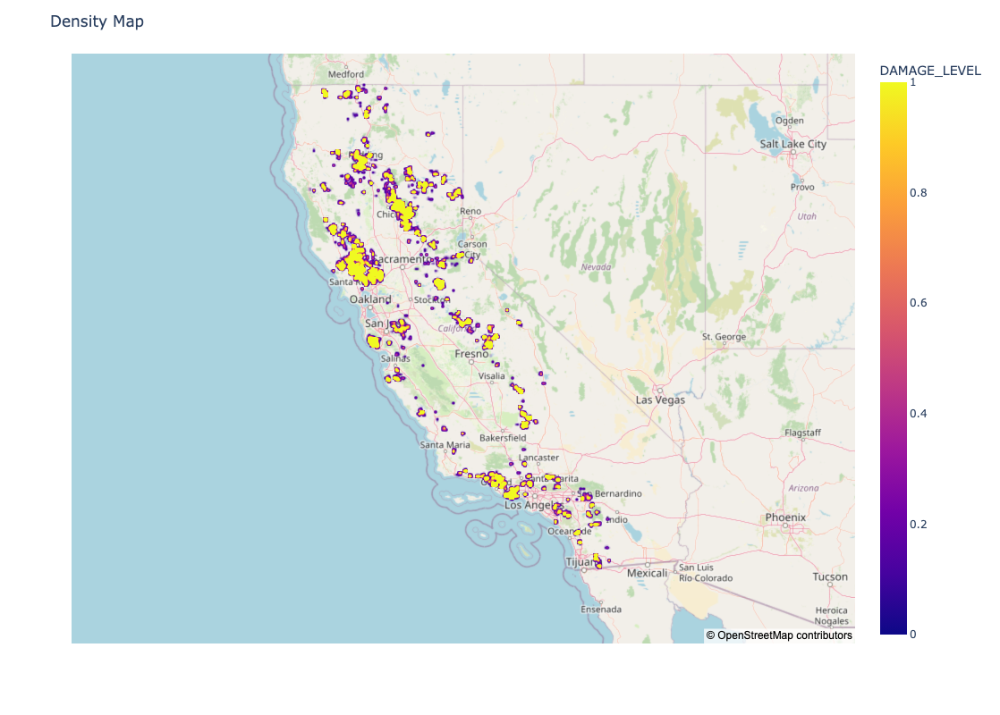

In [60]:
fig = px.density_mapbox(damages, lat='Latitude', lon='Longitude', radius=2, 
                        z='DAMAGE_LEVEL',
                        center=dict(lat=37, lon=-120), zoom=5,
                        mapbox_style="open-street-map")
# Adjust figure to be square
fig.update_layout(
    width=800,  # Set the width
    height=800,  # Set the height to make it square
    title="Density Map"
)
fig.show()

# electric grid

In [46]:
electric_grids = gpd.read_file("./archive/Transmission_Line_-3224603581692172535.geojson")

In [61]:
electric_grids.columns

Index(['OBJECTID', 'Name', 'kV', 'kV_Sort', 'Owner', 'Status', 'Circuit',
       'Type', 'Legend', 'Length_Mile', 'Length_Feet', 'TLine_Name', 'Source',
       'Comments', 'Creator', 'Creator_Date', 'Last_Editor',
       'Last_Editor_Date', 'GlobalID', 'geometry'],
      dtype='object')

In [47]:
electric_grids.iloc[57]

OBJECTID                                                           58
Name                                                        APUD 69kV
kV                                                                 69
kV_Sort                                                          69.0
Owner                                                            APUD
Status                                                    Operational
Circuit                                                        Single
Type                                                               UG
Legend                                                  Other_33_92kV
Length_Mile                                                       1.0
Length_Feet                                             7597.86906618
TLine_Name                                                       None
Source                                                           APUD
Comments                                                             
Creator             

In [48]:
geometry_ = electric_grids.geometry

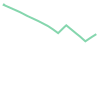

In [49]:
geometry_[0]

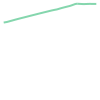

In [50]:
geometry_[57]

In [51]:
type(geometry_[57])

shapely.geometry.multilinestring.MultiLineString

In [52]:
# line = LineString([(37.0, -120.0), (37.5, -120.5), (38.0, -121.0)])
lines = []
for i in range(len(electric_grids.geometry)):
    latitudes = []
    longitudes = []
    if isinstance(electric_grids.geometry[i],shapely.geometry.linestring.LineString):
        for j in range(len(electric_grids.geometry[i].coords)):
            latitudes += [electric_grids.geometry[i].coords[j][1]]
            longitudes += [electric_grids.geometry[i].coords[j][0]]
    if isinstance(electric_grids.geometry[i],shapely.geometry.multilinestring.MultiLineString):
        multi_line = electric_grids.geometry[i].geoms
        for line in multi_line:
            for coord in line.coords:
                lon, lat = coord
                longitudes += [lon]
                latitudes += [lat]
    lines += [(latitudes,longitudes)]

In [53]:
lines[:1]

[([37.7724258669655,
   37.7720413833318,
   37.7697915485288,
   37.7686245896969,
   37.7670638486374,
   37.7654550230206,
   37.7644813150383,
   37.763316927701,
   37.765197196956,
   37.7657399406441,
   37.7632736192491,
   37.7621702777475,
   37.7607911306343,
   37.7620983110435,
   37.7630016462219],
  [-122.242914099121,
   -122.243142842531,
   -122.238051483453,
   -122.235813772894,
   -122.232443323593,
   -122.22935517975,
   -122.227888703405,
   -122.226292750183,
   -122.224370512681,
   -122.223774799391,
   -122.220785377704,
   -122.219416560807,
   -122.217863233543,
   -122.215923925355,
   -122.21447868698])]

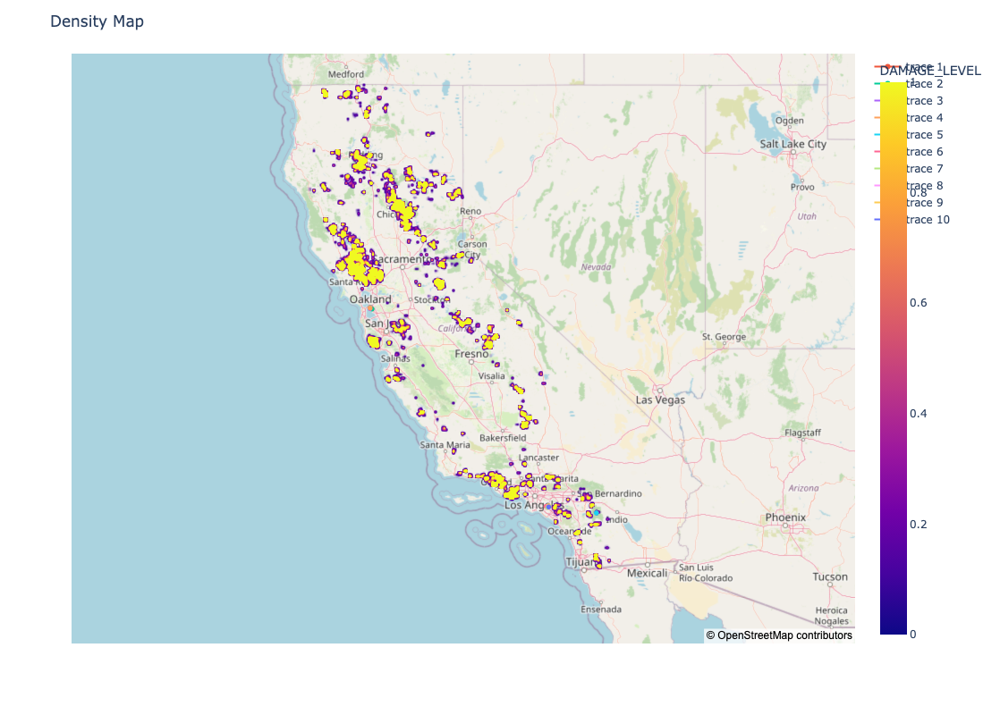

In [54]:
fig = px.density_mapbox(damages, lat='Latitude', lon='Longitude', radius=2, 
                        z='DAMAGE_LEVEL',
                        center=dict(lat=37, lon=-120), zoom=5,
                        mapbox_style="open-street-map")

for latitudes,longitudes in lines[:10]:
    fig.add_trace(go.Scattermapbox(
        mode='lines+markers',  # Plot lines and markers at each coordinate
        lat=latitudes[0:1],
        lon=longitudes[0:1],
    ))
# Adjust figure to be square
fig.update_layout(
    width=800,  # Set the width
    height=800,  # Set the height to make it square
    title="Density Map"
)

fig.show()

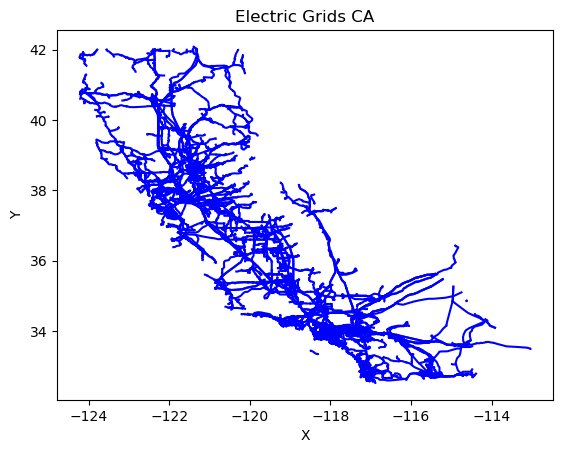

In [59]:
# Plotting
fig, ax = plt.subplots()
for line in lines:
    (latitudes,longitudes) = line
    ax.plot(longitudes, latitudes, color='blue')  # Plot the line

ax.set_title("Electric Grids CA")
ax.set_xlabel("X")
ax.set_ylabel("Y")
plt.show()

# us-billion-dollar-weather-and-climate-disasters

In [65]:
import csv
import pandas as pd

In [102]:
# https://catalog.data.gov/dataset/u-s-billion-dollar-weather-and-climate-disasters-1980-present-ncei-accession-02092681
file = "./archive/0209268/1.1/data/0-data/events-US-1980-2019.csv"
reports = pd.read_csv(file, skiprows=1)
# to do search wildfire names

In [104]:
reports.head(3)

,Name,Disaster,Begin Date,End Date,Total CPI-Adjusted Cost (Millions of Dollars),Deaths
0,Southern Severe Storms and Flooding (April 1980),Flooding,19800410,19800417,2339.4,7
1,Hurricane Allen (August 1980),Tropical Cyclone,19800807,19800811,1953.0,13
2,Central/Eastern Drought/Heatwave (Summer-Fall ...,Drought,19800601,19801130,33166.2,1260


In [105]:
reports.describe()

,Begin Date,End Date,Total CPI-Adjusted Cost (Millions of Dollars),Deaths
count,2.580000e+02,2.580000e+02,258.000000,258.000000
mean,2.005421e+07,2.005443e+07,6800.863178,51.352713
std,1.101692e+05,1.100144e+05,16449.064632,235.334491
min,1.980041e+07,1.980042e+07,973.000000,0.000000
25%,1.997047e+07,1.997292e+07,1524.875000,1.000000
50%,2.008078e+07,2.008091e+07,2287.050000,9.000000
75%,2.015048e+07,2.015052e+07,4542.625000,30.750000
max,2.019102e+07,2.019113e+07,168762.200000,2981.000000


In [106]:
reports.columns

Index(['Name', 'Disaster', 'Begin Date', 'End Date',
       'Total CPI-Adjusted Cost (Millions of Dollars)', 'Deaths'],
      dtype='object')

In [274]:
reports_numeric_columns = ['Begin Date', 'End Date','Total CPI-Adjusted Cost (Millions of Dollars)', 'Deaths']

In [275]:
reports[reports_numeric_columns].corr()

,Begin Date,End Date,Total CPI-Adjusted Cost (Millions of Dollars),Deaths
Begin Date,1.000000,0.999961,0.028534,-0.045364
End Date,0.999961,1.000000,0.028442,-0.045307
Total CPI-Adjusted Cost (Millions of Dollars),0.028534,0.028442,1.000000,0.648327
Deaths,-0.045364,-0.045307,0.648327,1.000000


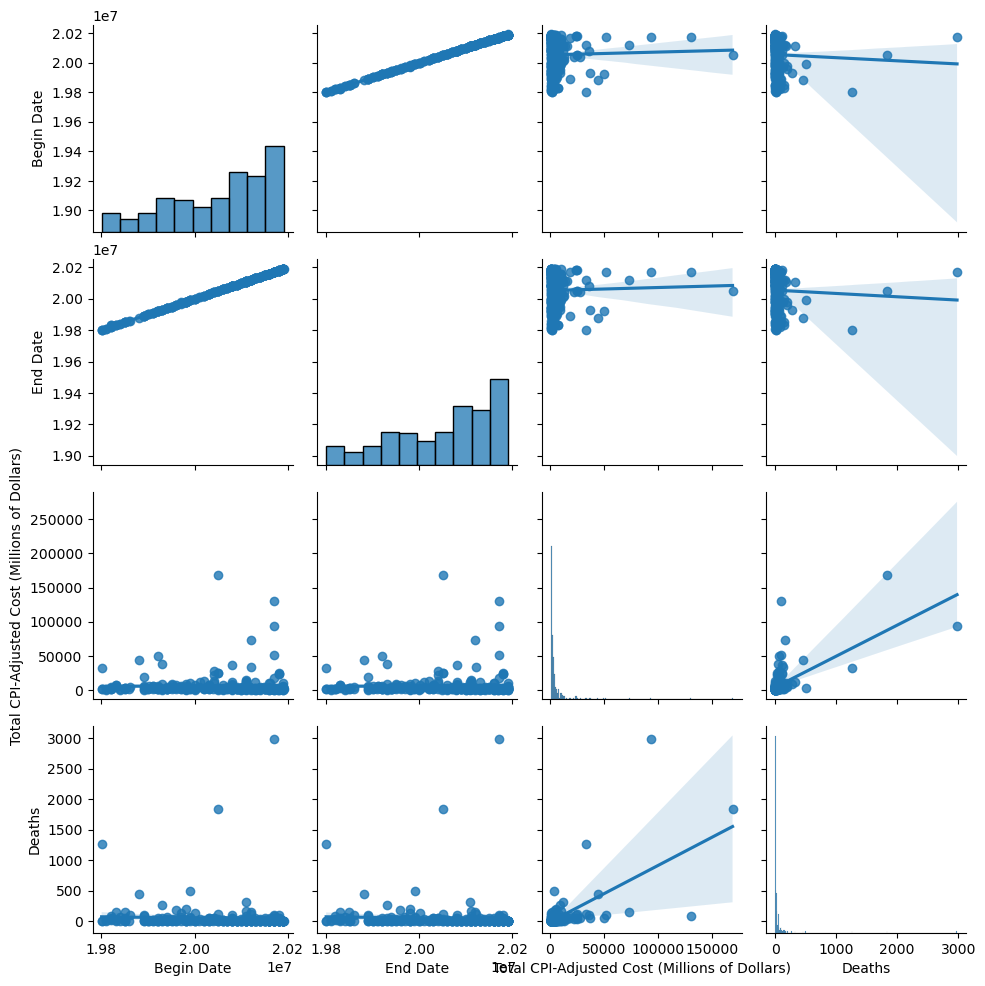

In [276]:
sns.pairplot(reports[reports_numeric_columns],kind="reg")

In [113]:
reports["Disaster"].unique()

array(['Flooding', 'Tropical Cyclone', 'Drought', 'Freeze',
       'Severe Storm', 'Winter Storm', 'Wildfire'], dtype=object)

In [278]:
reports_Wildfire = reports[reports["Disaster"]=="Wildfire"]
reports_Wildfire.head(5)

,Name,Disaster,Begin Date,End Date,Total CPI-Adjusted Cost (Millions of Dollars),Deaths
34,Oakland Firestorm (October 1991),Wildfire,19911001,19911031,6303.0,25
46,California Wildfires (Fall 1993),Wildfire,19930901,19931130,2468.7,4
52,Western Fire Season (Summer-Fall 1994),Wildfire,19940601,19941130,1276.0,0
81,Western Fire Season (Spring-Summer 2000),Wildfire,20000301,20000831,1634.0,0
89,Western Fire Season (Fall 2002),Wildfire,20020901,20021130,1918.1,21


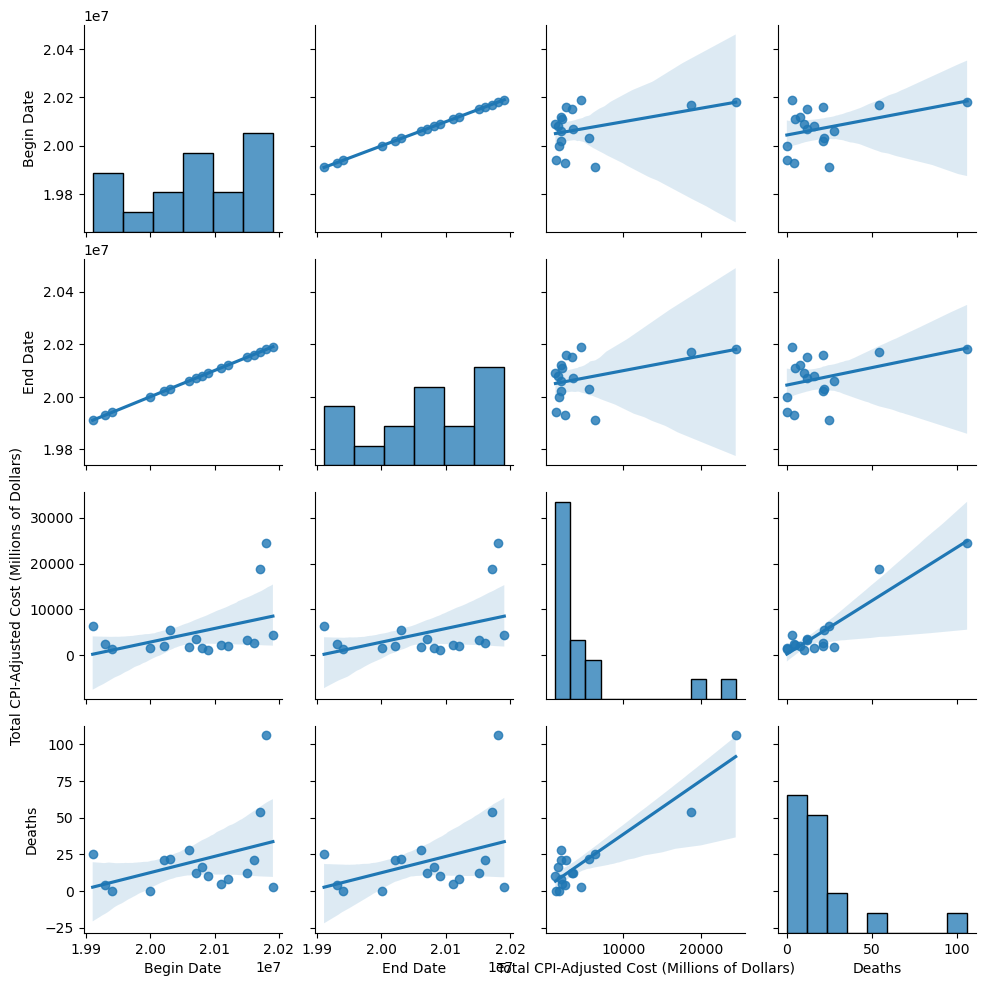

In [277]:
sns.pairplot(reports_Wildfire,kind="reg") # to do: do kdf as well, entropy analysis, etc

In [115]:
# how to connect these records to geogrphaic locations, and other datasets??

# Vegetation

In [122]:
# online visualization tool https://apps.wildlife.ca.gov/bios6/

In [197]:
# Read a feature class from a geodatabase
gdb_folder = "./archive/ds958/ds958.gdb/"
ds958 = gpd.read_file(gdb_folder)

# Now you can work with the data in the GeoDataFrame
# print(gdf.head())

In [148]:
# !pip3 install fiona

  Using cached click-8.1.8-py3-none-any.whl.metadata (2.3 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.1/16.1 MB 12.4 MB/s eta 0:00:00a 0:00:01
Using cached click-8.1.8-py3-none-any.whl (98 kB)


In [198]:
# List all layers in the .gdb
with fiona.drivers():
    layers = fiona.listlayers("./archive/ds958/ds958.gdb/")

print(layers)

['ds958']


/var/folders/kl/k501rhk96t5bjq54fmkg4j780000gn/T/ipykernel_87222/3625662210.py:2: FionaDeprecationWarning:

Use fiona.Env() instead.



# BIOS

# distribution

In [199]:
ds958.describe()

,Poly_ID,X_Centroid,Y_Centroid,Acres,Hectares,Shape_Length,Shape_Area
count,38.000000,38.000000,3.800000e+01,38.000000,38.000000,38.000000,38.000000
mean,19.500000,576079.342765,4.204265e+06,9.043782,3.659889,1009.915956,36622.948710
std,11.113055,323.657971,4.071363e+02,16.642819,6.735110,1368.260901,67395.367363
min,1.000000,575562.881397,4.203522e+06,0.039980,0.016179,49.901156,161.898234
25%,10.250000,575817.500770,4.204012e+06,0.635321,0.257105,269.061964,2572.746288
50%,19.500000,576090.152239,4.204284e+06,1.738284,0.703458,473.173189,7039.217679
75%,28.750000,576251.425592,4.204541e+06,13.673255,5.533370,1135.728253,55370.101178
max,38.000000,576678.668184,4.205022e+06,85.386155,34.554551,7120.245877,345772.624302


In [200]:
ds958.columns

Index(['NVCSName', 'NVCSLevel', 'MapClass', 'MapClass_ID', 'Poly_ID',
       'X_Centroid', 'Y_Centroid', 'CALVEGName', 'CALVEGCode', 'CWHRType',
       'CWHRCode', 'GlobalRank', 'StateRank', 'Rare', 'CaCode', 'NVCSAlliance',
       'NVCSGroup', 'NVCSMG', 'Acres', 'Hectares', 'Shape_Length',
       'Shape_Area', 'geometry'],
      dtype='object')

In [215]:
ds958_layer_0 = gpd.read_file("./archive/ds958/ds958.gdb/",layer=0)

In [216]:
ds958_layer_0.columns

Index(['NVCSName', 'NVCSLevel', 'MapClass', 'MapClass_ID', 'Poly_ID',
       'X_Centroid', 'Y_Centroid', 'CALVEGName', 'CALVEGCode', 'CWHRType',
       'CWHRCode', 'GlobalRank', 'StateRank', 'Rare', 'CaCode', 'NVCSAlliance',
       'NVCSGroup', 'NVCSMG', 'Acres', 'Hectares', 'Shape_Length',
       'Shape_Area', 'geometry'],
      dtype='object')

In [217]:
ds958_layer_0.head(1)

,NVCSName,NVCSLevel,MapClass,MapClass_ID,Poly_ID,X_Centroid,Y_Centroid,CALVEGName,CALVEGCode,CWHRType,...,Rare,CaCode,NVCSAlliance,NVCSGroup,NVCSMG,Acres,Hectares,Shape_Length,Shape_Area,geometry
0,Lolium perenne,Semi-natural Stands,Ryegrass Grassland,RG,1,576412.451725,4.204008e+06,Annual Grasses and Forbs,HG,Annual Grassland,...,No,41.321.00,Lolium perenne,Mediterranean California naturalized annual an...,California Annual and Perennial Grassland,0.258657,0.104675,156.134687,1047.434589,"MULTIPOLYGON (((-186800.975 -1871.161, -186799..."


In [218]:
ds958_layer_0.NVCSLevel.unique()

array(['Semi-natural Stands', 'Group', None, 'Alliance'], dtype=object)

In [219]:
ds958_CALVEGName_uniques = ds958_layer_0.CALVEGName.unique().tolist()
print(ds958_CALVEGName_uniques)

['Annual Grasses and Forbs', 'Wet Meadows', 'Urban', 'Coast Live Oak', 'California Bay', 'Blue Oak', 'Coyote Brush', 'California Buckeye', 'Valley Oak', 'Chamise', 'Orchard Agriculture', '\tPerennial Grasses and Forbs', 'Coastal Mixed Hardwood']


In [248]:
ds958_layer_0["CALVEGName"] = ds958_layer_0["CALVEGName"].replace("\tPerennial Grasses and Forbs", "perennial")

In [249]:
ds958_CALVEGName_uniques = ds958_layer_0.CALVEGName.unique()
ds958_CALVEGName_uniques

array(['Annual Grasses and Forbs', 'Wet Meadows', 'Urban',
       'Coast Live Oak', 'California Bay', 'Blue Oak', 'Coyote Brush',
       'California Buckeye', 'Valley Oak', 'Chamise',
       'Orchard Agriculture', 'perennial', 'Coastal Mixed Hardwood'],
      dtype=object)

In [250]:
dic_type_to_flammability = {
    "Urban": 1,
    "Wet Meadows": 2,
    "Coastal Mixed Hardwood": 3,
    "Perennial Grasses and Forbs": 4,
    "Blue Oak": 5,
    "Coast Live Oak": 6,
    "Valley Oak": 7,
    "California Buckeye": 8,
    "California Bay": 9,
    "Chamise": 10,
    "Annual Grasses and Forbs": 11,
    "Coyote Brush": 12
}

In [233]:
dic = {ds958_CALVEGName_uniques[i]:i for i in range(len(ds958_CALVEGName_uniques))}
print(dic)

{'Annual Grasses and Forbs': 0, 'Wet Meadows': 1, 'Urban': 2, 'Coast Live Oak': 3, 'California Bay': 4, 'Blue Oak': 5, 'Coyote Brush': 6, 'California Buckeye': 7, 'Valley Oak': 8, 'Chamise': 9, 'Orchard Agriculture': 10, '\tPerennial Grasses and Forbs': 11, 'Coastal Mixed Hardwood': 12}


In [270]:
ds958_layer_0[["CALVEGName_is_Urban"]] = (ds958_layer_0[["CALVEGName"]]=="Urban").astype(int)
ds958_layer_0.drop(columns=["CALVEGName_is_Urban"])
ds958_layer_0["flammability"] = ds958_layer_0.CALVEGName.map(dic_type_to_flammability)
ds958_layer_0.head(1)

,NVCSName,NVCSLevel,MapClass,MapClass_ID,Poly_ID,X_Centroid,Y_Centroid,CALVEGName,CALVEGCode,CWHRType,...,NVCSAlliance,NVCSGroup,NVCSMG,Acres,Hectares,Shape_Length,Shape_Area,geometry,CALVEGName_is_Urban,flammability
0,Lolium perenne,Semi-natural Stands,Ryegrass Grassland,RG,1,576412.451725,4.204008e+06,Annual Grasses and Forbs,HG,Annual Grassland,...,Lolium perenne,Mediterranean California naturalized annual an...,California Annual and Perennial Grassland,0.258657,0.104675,156.134687,1047.434589,"MULTIPOLYGON (((-186800.975 -1871.161, -186799...",0,11.0


In [259]:
numeric_columns = ["X_Centroid","Y_Centroid","Acres","Hectares","Shape_Length","Shape_Area","flammability"]

In [261]:
ds958_layer_0[numeric_columns].head(2)

,X_Centroid,Y_Centroid,Acres,Hectares,Shape_Length,Shape_Area,flammability
0,576412.451725,4.204008e+06,0.258657,0.104675,156.134687,1047.434589,11.0
1,576231.773805,4.203990e+06,0.511273,0.206905,274.364102,2070.410390,11.0


In [262]:
ds958_layer_0[numeric_columns].describe()

,X_Centroid,Y_Centroid,Acres,Hectares,Shape_Length,Shape_Area,flammability
count,38.000000,3.800000e+01,38.000000,38.000000,38.000000,38.000000,36.000000
mean,576079.342765,4.204265e+06,9.043782,3.659889,1009.915956,36622.948710,7.861111
std,323.657971,4.071363e+02,16.642819,6.735110,1368.260901,67395.367363,3.154614
min,575562.881397,4.203522e+06,0.039980,0.016179,49.901156,161.898234,1.000000
25%,575817.500770,4.204012e+06,0.635321,0.257105,269.061964,2572.746288,6.000000
50%,576090.152239,4.204284e+06,1.738284,0.703458,473.173189,7039.217679,8.000000
75%,576251.425592,4.204541e+06,13.673255,5.533370,1135.728253,55370.101178,11.000000
max,576678.668184,4.205022e+06,85.386155,34.554551,7120.245877,345772.624302,12.000000


In [263]:
ds958_layer_0[numeric_columns].corr()

,X_Centroid,Y_Centroid,Acres,Hectares,Shape_Length,Shape_Area,flammability
X_Centroid,1.000000,-0.240675,0.145672,0.145672,0.194290,0.145672,0.117599
Y_Centroid,-0.240675,1.000000,-0.005998,-0.005998,-0.071933,-0.005998,0.047019
Acres,0.145672,-0.005998,1.000000,1.000000,0.975852,1.000000,-0.034304
Hectares,0.145672,-0.005998,1.000000,1.000000,0.975852,1.000000,-0.034304
Shape_Length,0.194290,-0.071933,0.975852,0.975852,1.000000,0.975852,-0.028301
Shape_Area,0.145672,-0.005998,1.000000,1.000000,0.975852,1.000000,-0.034304
flammability,0.117599,0.047019,-0.034304,-0.034304,-0.028301,-0.034304,1.000000


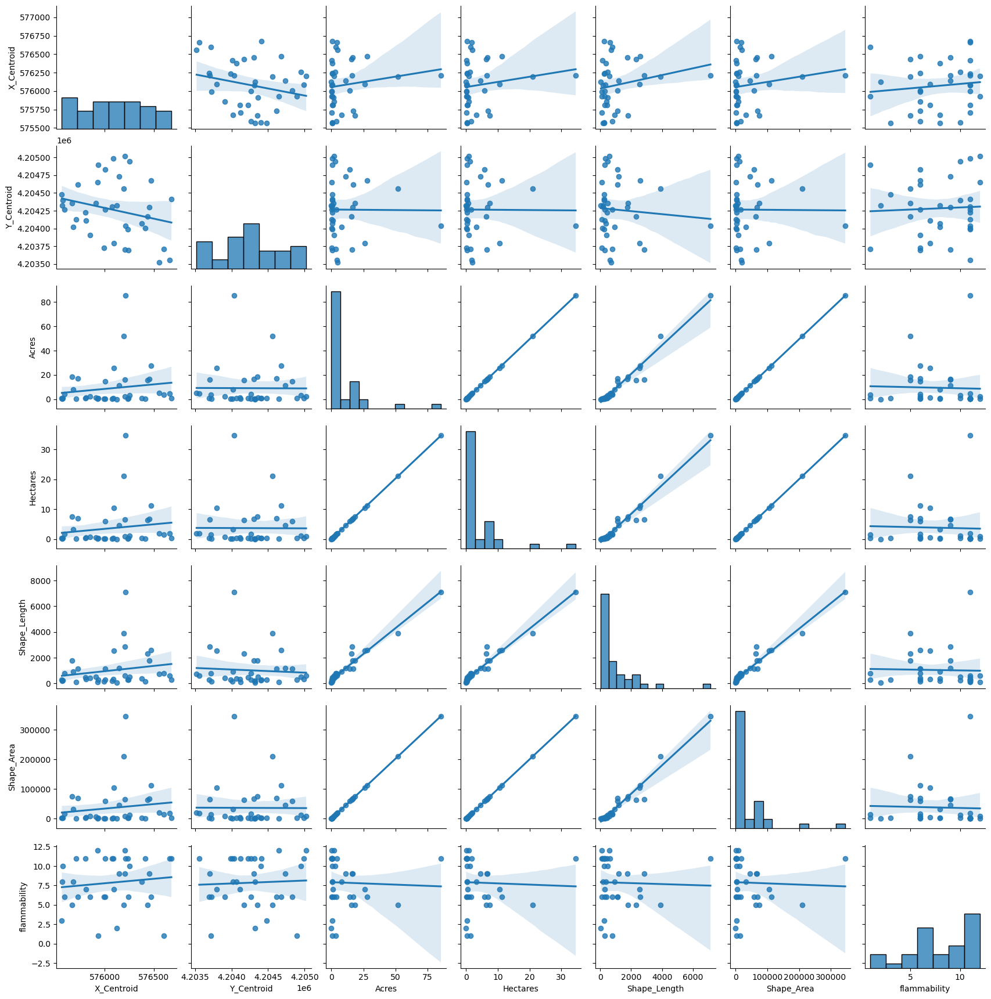

In [272]:
sns.pairplot(ds958_layer_0[numeric_columns],kind="reg")

<Axes: >

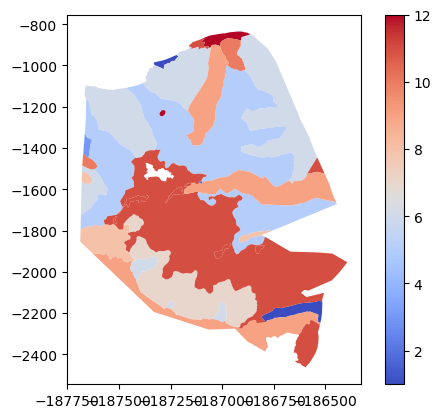

In [271]:
ds958_layer_0.plot(column='flammability', cmap='coolwarm', legend=True)